In [1]:
import torch
import os
import torch.nn as nn
import torch.utils.data as data
from PIL import Image
from PIL import ImageFile
from torch import nn, optim
from torch.autograd.variable import Variable
from torchvision import transforms, datasets
from utils import Logger
from sampler import InfiniteSamplerWrapper
from function import calc_mean_std

Image.MAX_IMAGE_PIXELS = None  # Disable DecompressionBombError
ImageFile.LOAD_TRUNCATED_IMAGES = True  # Disable OSError: image file is truncated

In [2]:
device = torch.device('cpu')

In [3]:
decoder = nn.Sequential(
    nn.ReflectionPad2d((1, 1, 1, 1)),
    nn.Conv2d(512, 256, (3, 3)),
    nn.ReLU(),
    nn.Upsample(scale_factor=2, mode='nearest'),
    nn.ReflectionPad2d((1, 1, 1, 1)),
    nn.Conv2d(256, 256, (3, 3)),
    nn.ReLU(),
    nn.ReflectionPad2d((1, 1, 1, 1)),
    nn.Conv2d(256, 256, (3, 3)),
    nn.ReLU(),
    nn.ReflectionPad2d((1, 1, 1, 1)),
    nn.Conv2d(256, 256, (3, 3)),
    nn.ReLU(),
    nn.ReflectionPad2d((1, 1, 1, 1)),
    nn.Conv2d(256, 128, (3, 3)),
    nn.ReLU(),
    nn.Upsample(scale_factor=2, mode='nearest'),
    nn.ReflectionPad2d((1, 1, 1, 1)),
    nn.Conv2d(128, 128, (3, 3)),
    nn.ReLU(),
    nn.ReflectionPad2d((1, 1, 1, 1)),
    nn.Conv2d(128, 64, (3, 3)),
    nn.ReLU(),
    nn.Upsample(scale_factor=2, mode='nearest'),
    nn.ReflectionPad2d((1, 1, 1, 1)),
    nn.Conv2d(64, 64, (3, 3)),
    nn.ReLU(),
    nn.ReflectionPad2d((1, 1, 1, 1)),
    nn.Conv2d(64, 3, (3, 3)),
)

vgg = nn.Sequential(
    nn.Conv2d(3, 3, (1, 1)),
    nn.ReflectionPad2d((1, 1, 1, 1)),
    nn.Conv2d(3, 64, (3, 3)),
    nn.ReLU(),  # relu1-1
    nn.ReflectionPad2d((1, 1, 1, 1)),
    nn.Conv2d(64, 64, (3, 3)),
    nn.ReLU(),  # relu1-2
    nn.MaxPool2d((2, 2), (2, 2), (0, 0), ceil_mode=True),
    nn.ReflectionPad2d((1, 1, 1, 1)),
    nn.Conv2d(64, 128, (3, 3)),
    nn.ReLU(),  # relu2-1
    nn.ReflectionPad2d((1, 1, 1, 1)),
    nn.Conv2d(128, 128, (3, 3)),
    nn.ReLU(),  # relu2-2
    nn.MaxPool2d((2, 2), (2, 2), (0, 0), ceil_mode=True),
    nn.ReflectionPad2d((1, 1, 1, 1)),
    nn.Conv2d(128, 256, (3, 3)),
    nn.ReLU(),  # relu3-1
    nn.ReflectionPad2d((1, 1, 1, 1)),
    nn.Conv2d(256, 256, (3, 3)),
    nn.ReLU(),  # relu3-2
    nn.ReflectionPad2d((1, 1, 1, 1)),
    nn.Conv2d(256, 256, (3, 3)),
    nn.ReLU(),  # relu3-3
    nn.ReflectionPad2d((1, 1, 1, 1)),
    nn.Conv2d(256, 256, (3, 3)),
    nn.ReLU(),  # relu3-4
    nn.MaxPool2d((2, 2), (2, 2), (0, 0), ceil_mode=True),
    nn.ReflectionPad2d((1, 1, 1, 1)),
    nn.Conv2d(256, 512, (3, 3)),
    nn.ReLU(),  # relu4-1, this is the last layer used
    nn.ReflectionPad2d((1, 1, 1, 1)),
    nn.Conv2d(512, 512, (3, 3)),
    nn.ReLU(),  # relu4-2
    nn.ReflectionPad2d((1, 1, 1, 1)),
    nn.Conv2d(512, 512, (3, 3)),
    nn.ReLU(),  # relu4-3
    nn.ReflectionPad2d((1, 1, 1, 1)),
    nn.Conv2d(512, 512, (3, 3)),
    nn.ReLU(),  # relu4-4
    nn.MaxPool2d((2, 2), (2, 2), (0, 0), ceil_mode=True),
    nn.ReflectionPad2d((1, 1, 1, 1)),
    nn.Conv2d(512, 512, (3, 3)),
    nn.ReLU(),  # relu5-1
    nn.ReflectionPad2d((1, 1, 1, 1)),
    nn.Conv2d(512, 512, (3, 3)),
    nn.ReLU(),  # relu5-2
    nn.ReflectionPad2d((1, 1, 1, 1)),
    nn.Conv2d(512, 512, (3, 3)),
    nn.ReLU(),  # relu5-3
    nn.ReflectionPad2d((1, 1, 1, 1)),
    nn.Conv2d(512, 512, (3, 3)),
    nn.ReLU()  # relu5-4
)

In [4]:
decoder_path = "/home/chengbin/naiqi/stylize-datasets/models/decoder.pth"
vgg_path = "/home/chengbin/naiqi/stylize-datasets/models/vgg_normalised.pth"

decoder.eval()
vgg.eval()

decoder.load_state_dict(torch.load(decoder_path))
vgg.load_state_dict(torch.load(vgg_path))
vgg = nn.Sequential(*list(vgg.children())[:31])

vgg.to(device)
decoder.to(device)

Sequential(
  (0): ReflectionPad2d((1, 1, 1, 1))
  (1): Conv2d(512, 256, kernel_size=(3, 3), stride=(1, 1))
  (2): ReLU()
  (3): Upsample(scale_factor=2.0, mode=nearest)
  (4): ReflectionPad2d((1, 1, 1, 1))
  (5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1))
  (6): ReLU()
  (7): ReflectionPad2d((1, 1, 1, 1))
  (8): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1))
  (9): ReLU()
  (10): ReflectionPad2d((1, 1, 1, 1))
  (11): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1))
  (12): ReLU()
  (13): ReflectionPad2d((1, 1, 1, 1))
  (14): Conv2d(256, 128, kernel_size=(3, 3), stride=(1, 1))
  (15): ReLU()
  (16): Upsample(scale_factor=2.0, mode=nearest)
  (17): ReflectionPad2d((1, 1, 1, 1))
  (18): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1))
  (19): ReLU()
  (20): ReflectionPad2d((1, 1, 1, 1))
  (21): Conv2d(128, 64, kernel_size=(3, 3), stride=(1, 1))
  (22): ReLU()
  (23): Upsample(scale_factor=2.0, mode=nearest)
  (24): ReflectionPad2d((1, 1, 1, 1))
  (25): Conv2d(64, 64, 

In [5]:
class GeneratorNet(torch.nn.Module):
    """
    A three hidden-layer generative neural network
    """
    def __init__(self):
        super(GeneratorNet, self).__init__()
        n_features = 100
        n_out = 960*2
        
        self.hidden0 = nn.Sequential(
            nn.Linear(n_features, 256),
            nn.LeakyReLU(0.2)
        )
        self.hidden1 = nn.Sequential(            
            nn.Linear(256, 512),
            nn.LeakyReLU(0.2)
        )
        self.hidden2 = nn.Sequential(
            nn.Linear(512, 1024),
            nn.LeakyReLU(0.2)
        )
        
        self.out = nn.Sequential(
            nn.Linear(1024, n_out),
            nn.Tanh()
        )

    def forward(self, x):
        x = self.hidden0(x)
        x = self.hidden1(x)
        x = self.hidden2(x)
        x = self.out(x)
        return x
generator = GeneratorNet()

In [6]:
def noise(size, device = torch.device('cuda')):
    '''
    Generates a 1-d vector of gaussian sampled random values
    '''
    n = Variable(torch.randn(size, 100))
    return n.to(device)

In [7]:
def adain(content_feat, style_mean, style_std):
    size = content_feat.size()
    content_mean, content_std = calc_mean_std(content_feat)
    normalized_feat = (content_feat - content_mean.expand(
        size)) / content_std.expand(size)
    return normalized_feat * style_std.expand(size) + style_mean.expand(size)

def style_transfer(vgg, decoder, content, style_mean, style_std, alpha=1.0,
                   interpolation_weights=None):
    assert (0.0 <= alpha <= 1.0)
    content_f = vgg(content)
    t = adain(content_f, style_mean[-1], style_std[-1])
    feat = alpha * t + (1 - alpha) * content_f
    return decoder(feat)

In [8]:
def split_feat(fs):
    idx = [0, 64, 192, 448, 960]
    N = fs.size()[0]
    m1, m2, m3, m4 = [fs[:, idx[k]:idx[k+1]].view(N, -1, 1, 1) for k in range(4)]
    s1, s2, s3, s4 = [fs[:, idx[k]+960:idx[k+1]+960].view(N, -1, 1, 1) for k in range(4)]
    return [m1, m2, m3, m4], [s1, s2, s3, s4]

In [20]:
def train_transform():
    transform_list = [
        transforms.Resize(size=(512, 512)),
        transforms.CenterCrop(256),
        transforms.ToTensor()
    ]
    return transforms.Compose(transform_list)

In [10]:
def images_to_vectors(images):
    return images.view(images.size(0), -1)

def vectors_to_images(vectors):
    return vectors.view(vectors.size(0), 3, 256, 256)

In [ ]:
generator.load_state_dict(torch.load('./models/g_model'))
generator.to(device)

In [21]:
content_path = './example/3.JPEG' 
content_tf = train_transform()
content = content_tf(Image.open(content_path))
content = content.to(device).unsqueeze(0)

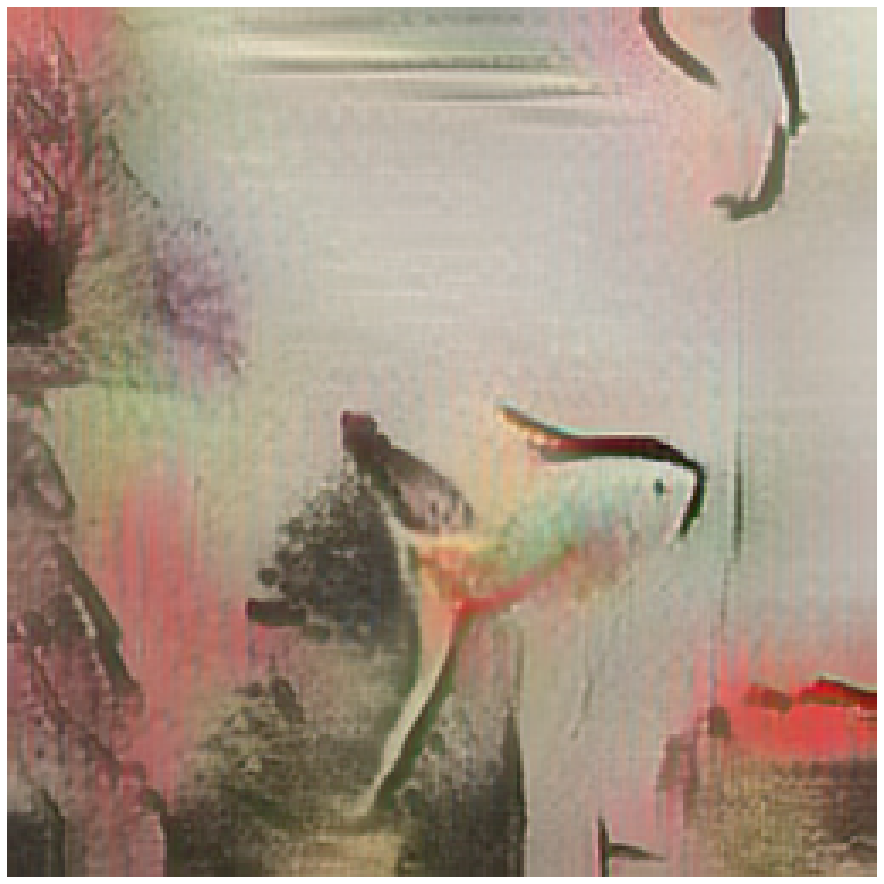

In [22]:
test_noise = noise(1, device)
test_feats = generator(test_noise)       
style_mean, style_std = split_feat(test_feats)

logger = Logger(model_name='G_visualize', data_name='Style')

max_iter=i=0
with torch.no_grad():
    test_images = style_transfer(vgg, decoder, content, style_mean, style_std)
test_images = vectors_to_images(test_images)
test_images = test_images.data.cpu()
logger.log_images(
    test_images, 1, 
    i, 0, 0
);

Find a random pair of orthogonal vectors v1 and v2 with gram-schmidt (dim=100)

In [27]:
import numpy as np
from numpy.linalg import norm

In [30]:
def get_orth():
    v1 = np.random.randn(100)
    v1 = v1 / norm(v1)

    v2 = np.random.randn(100)
    coe = np.dot(v1, v2)
    v2 = v2 - v1 * coe
    v2 = v2 / norm(v2)
    return v1, v2

In [32]:
v1, v2 = get_orth()
print(np.dot(v1, v2))

-2.905661822261152e-17


Make style grid of v1 v2

In [33]:
scale = np.arange(-1.5, 1.5001, 0.3)
print(scale)

[-1.50000000e+00 -1.20000000e+00 -9.00000000e-01 -6.00000000e-01
 -3.00000000e-01  2.22044605e-16  3.00000000e-01  6.00000000e-01
  9.00000000e-01  1.20000000e+00  1.50000000e+00]


In [45]:


imgs = []
for i in scale:
    for j in scale:
        v = i*v1 + j*v2
        noise = torch.from_numpy(10*v).float().view(1, 100)
        test_feats = generator(noise)       
        style_mean, style_std = split_feat(test_feats)
        with torch.no_grad():
            test_images = style_transfer(vgg, decoder, content, style_mean, style_std)
        imgs.append(test_images)

In [46]:
%matplotlib inline
def show(img):
    npimg = img.numpy()
    plt.imshow(np.transpose(npimg, (1,2,0)), interpolation='nearest')

In [47]:
from torchvision.utils import make_grid
import matplotlib.pyplot as plt

grid = make_grid([img.squeeze() for img in imgs], nrow=11)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


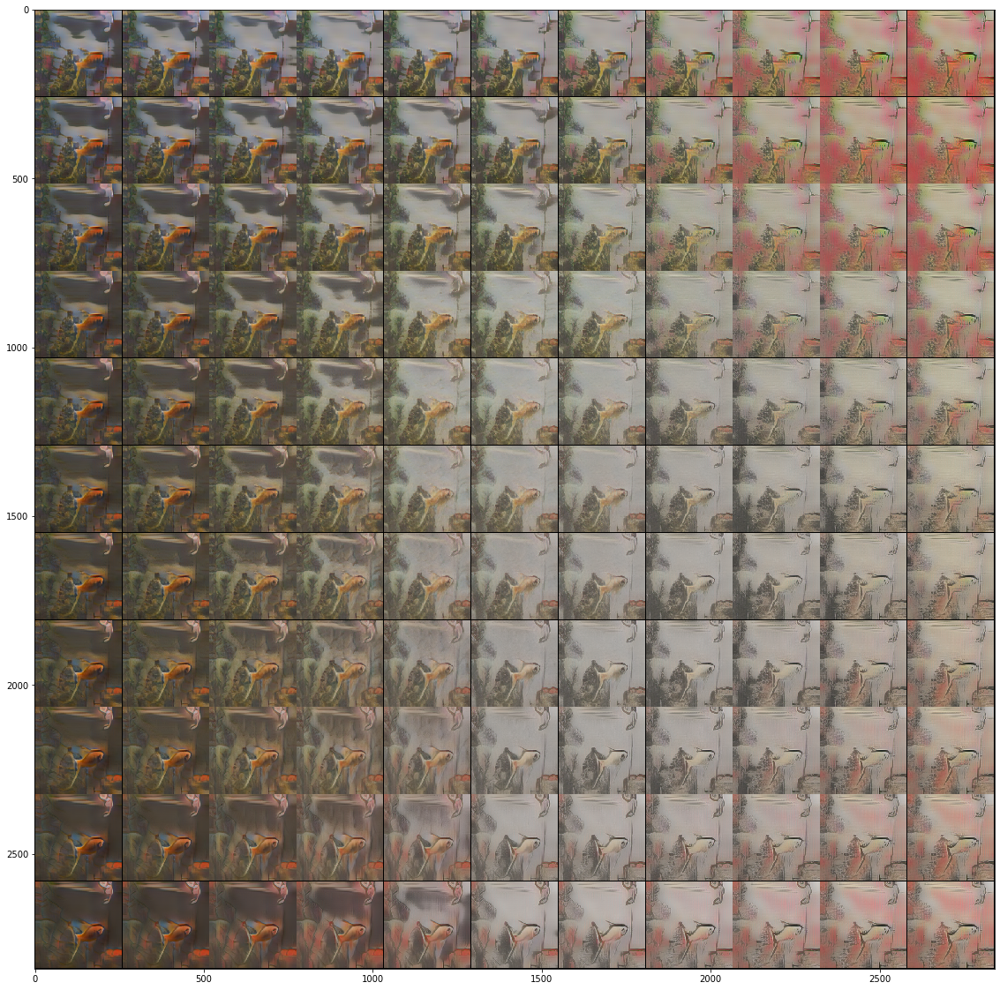

In [48]:
plt.figure(figsize=(20,20))
show(grid)

In [49]:
def style_grid(v1, v2):
    imgs = []
    for i in scale:
        for j in scale:
            v = i*v1 + j*v2
            noise = torch.from_numpy(10*v).float().view(1, 100)
            test_feats = generator(noise)       
            style_mean, style_std = split_feat(test_feats)
            with torch.no_grad():
                test_images = style_transfer(vgg, decoder, content, style_mean, style_std)
            imgs.append(test_images)
    grid = make_grid([img.squeeze() for img in imgs], nrow=11)
    return grid

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

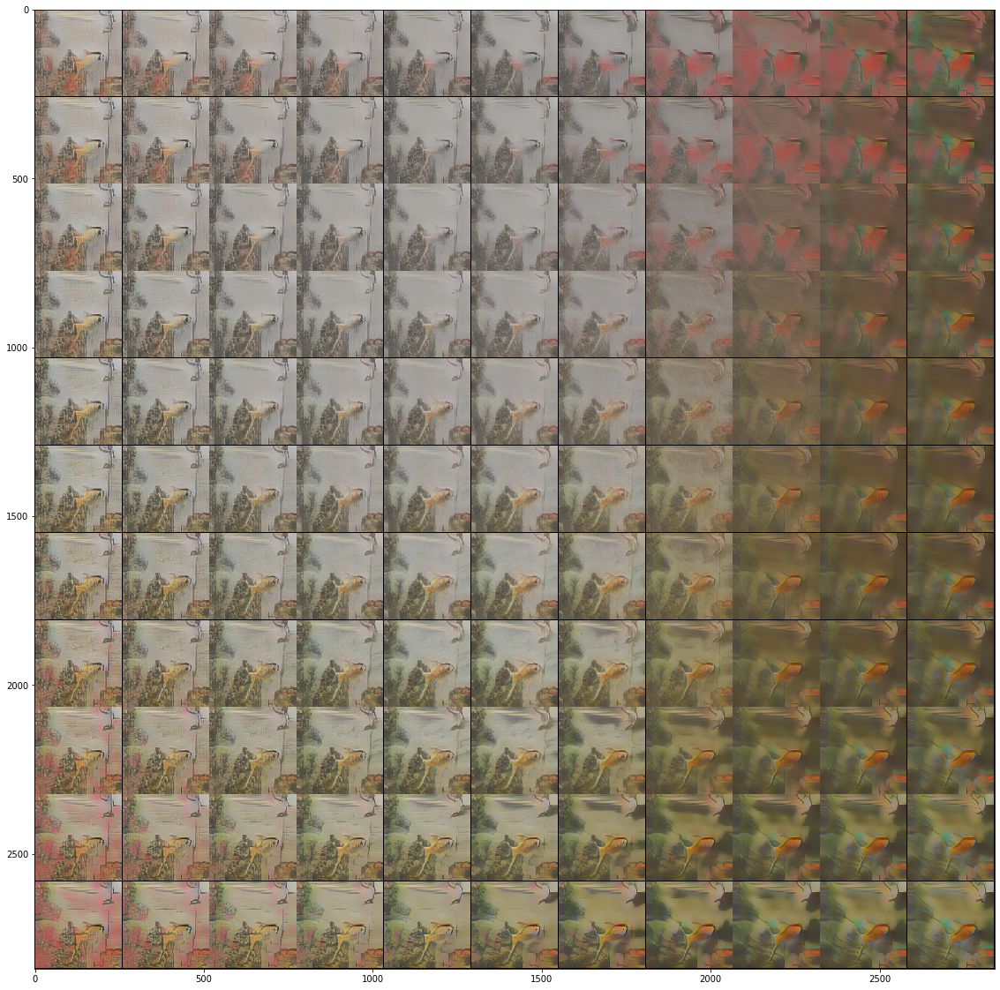

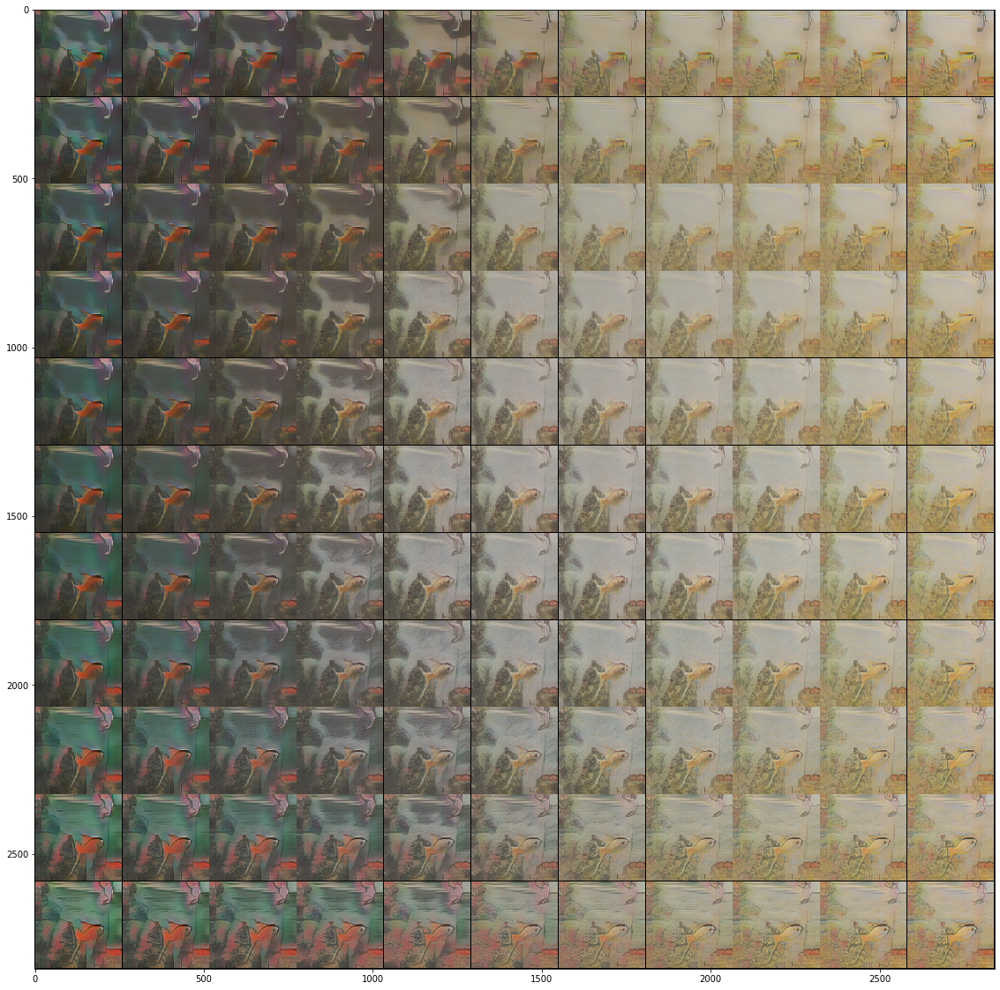

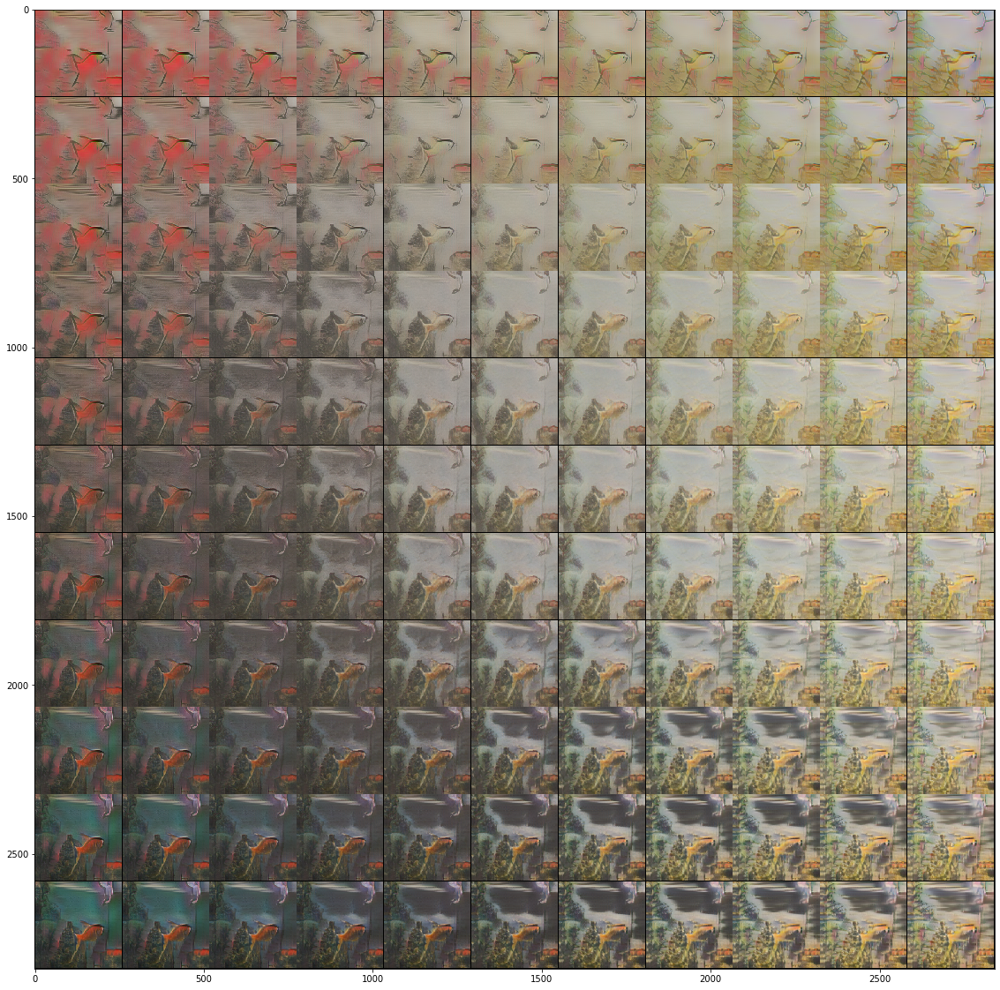

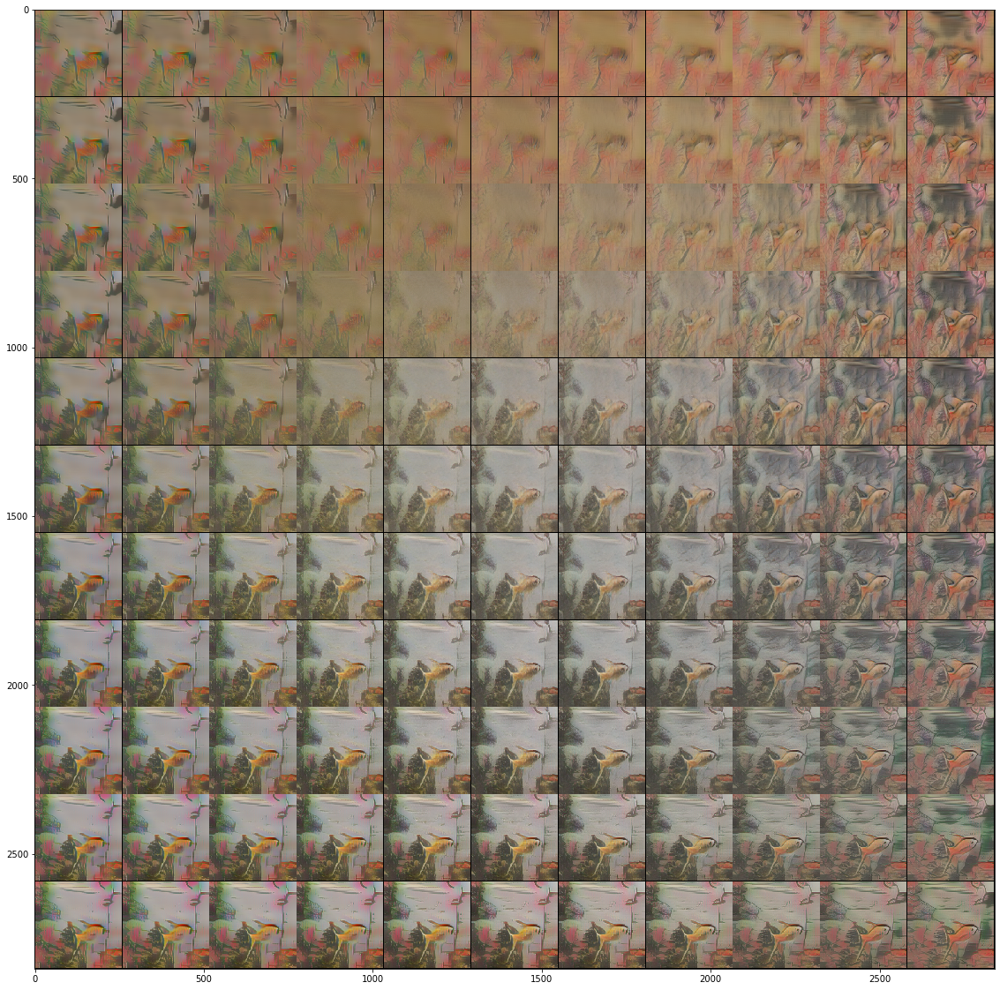

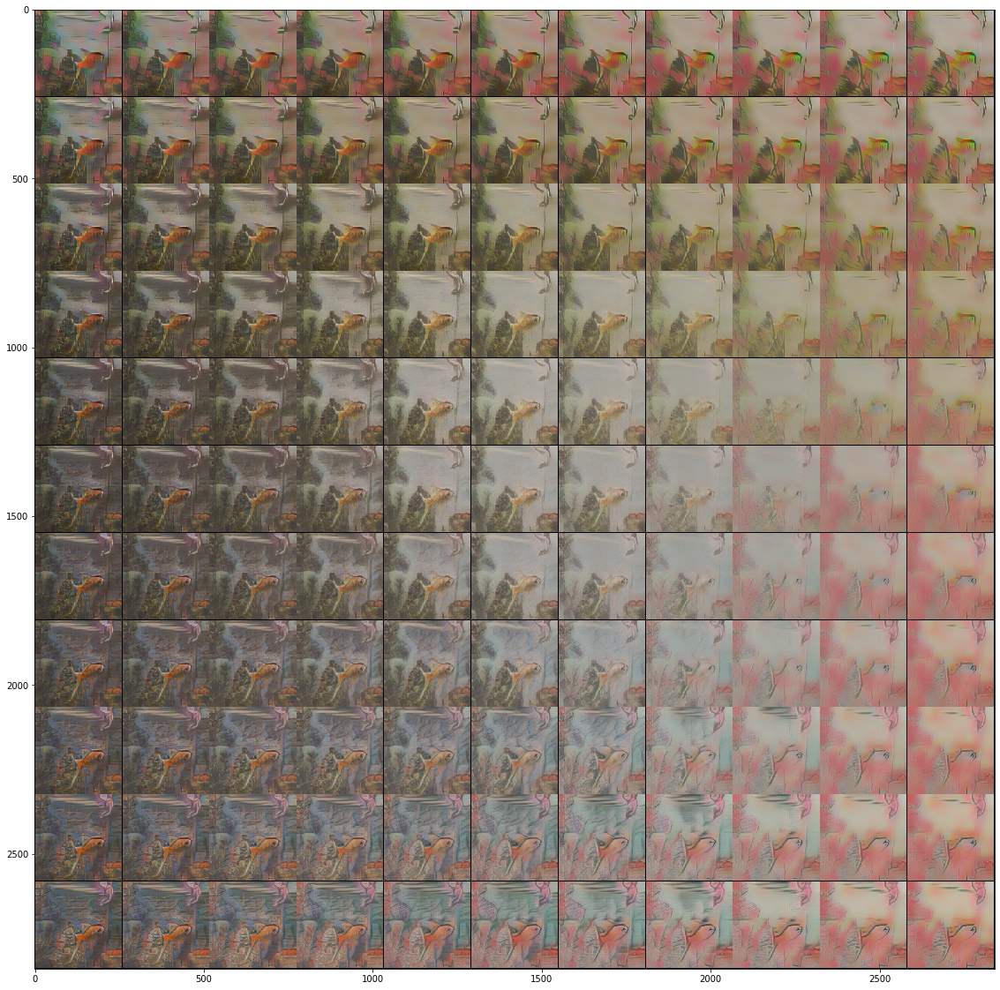

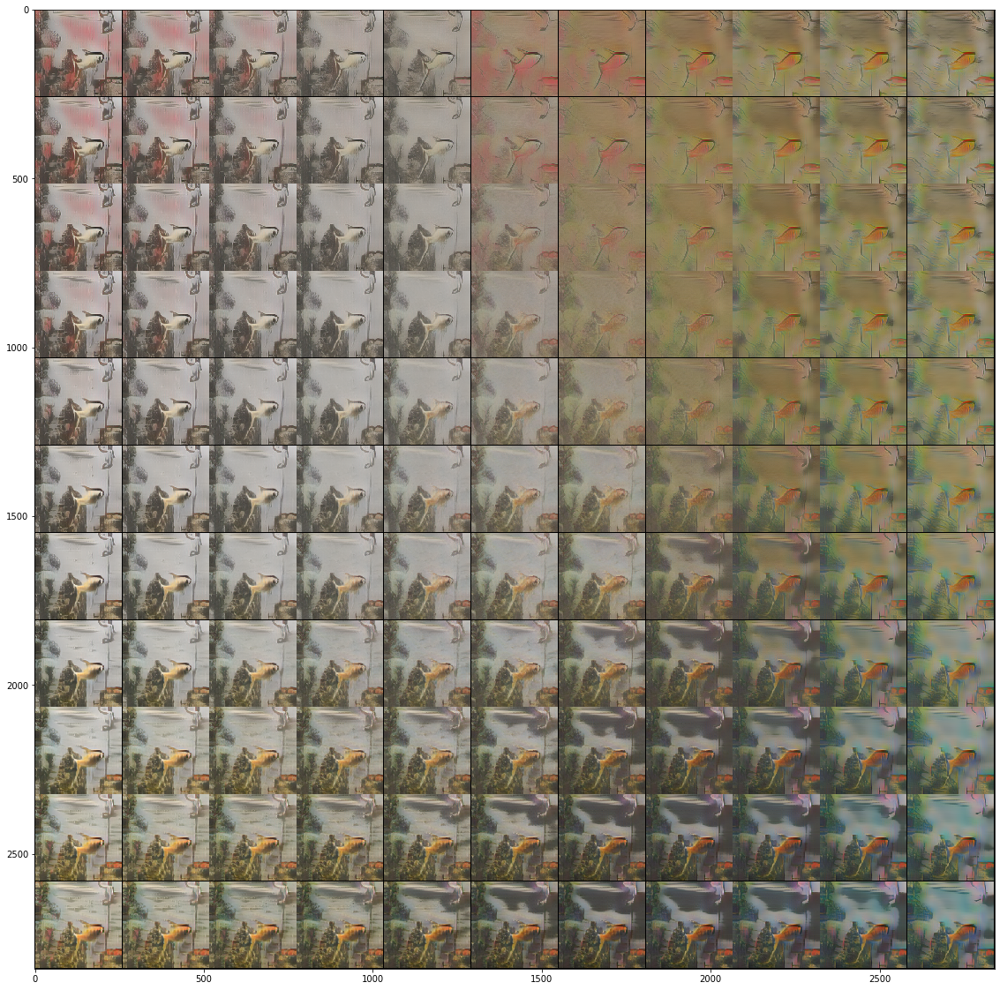

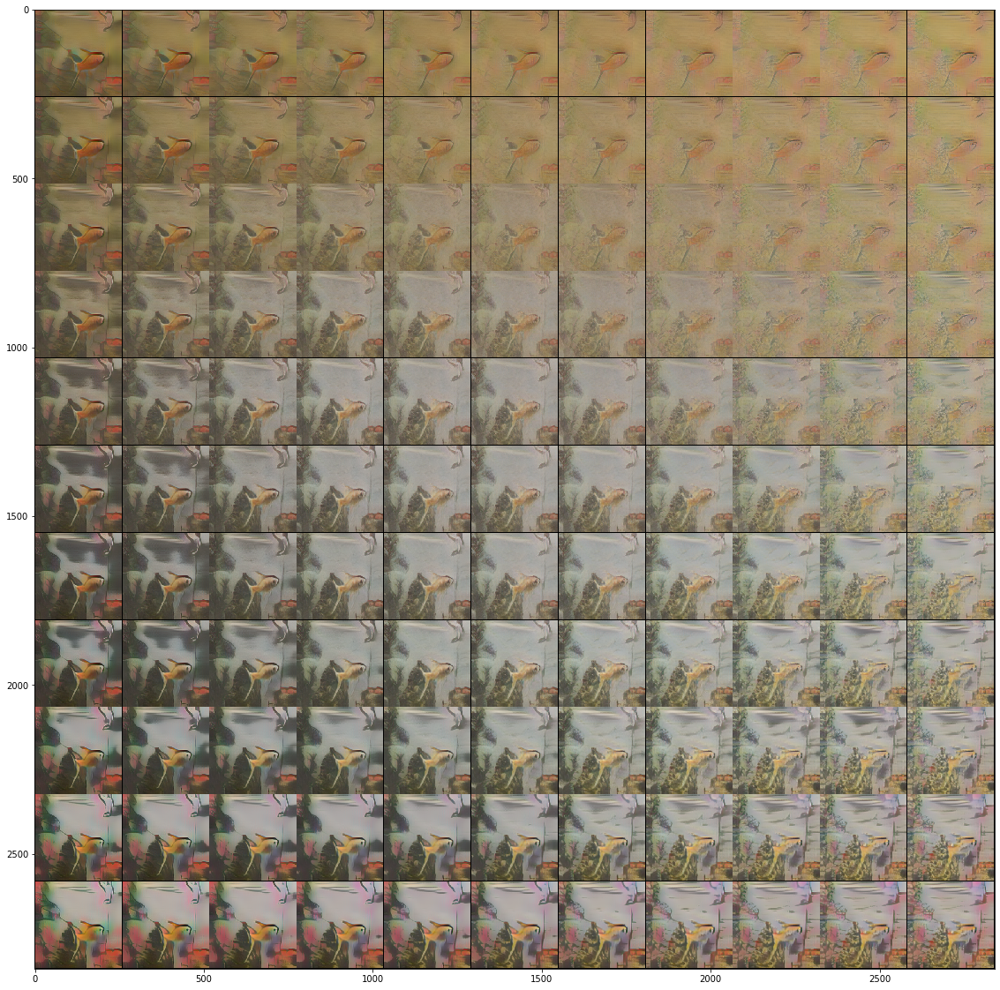

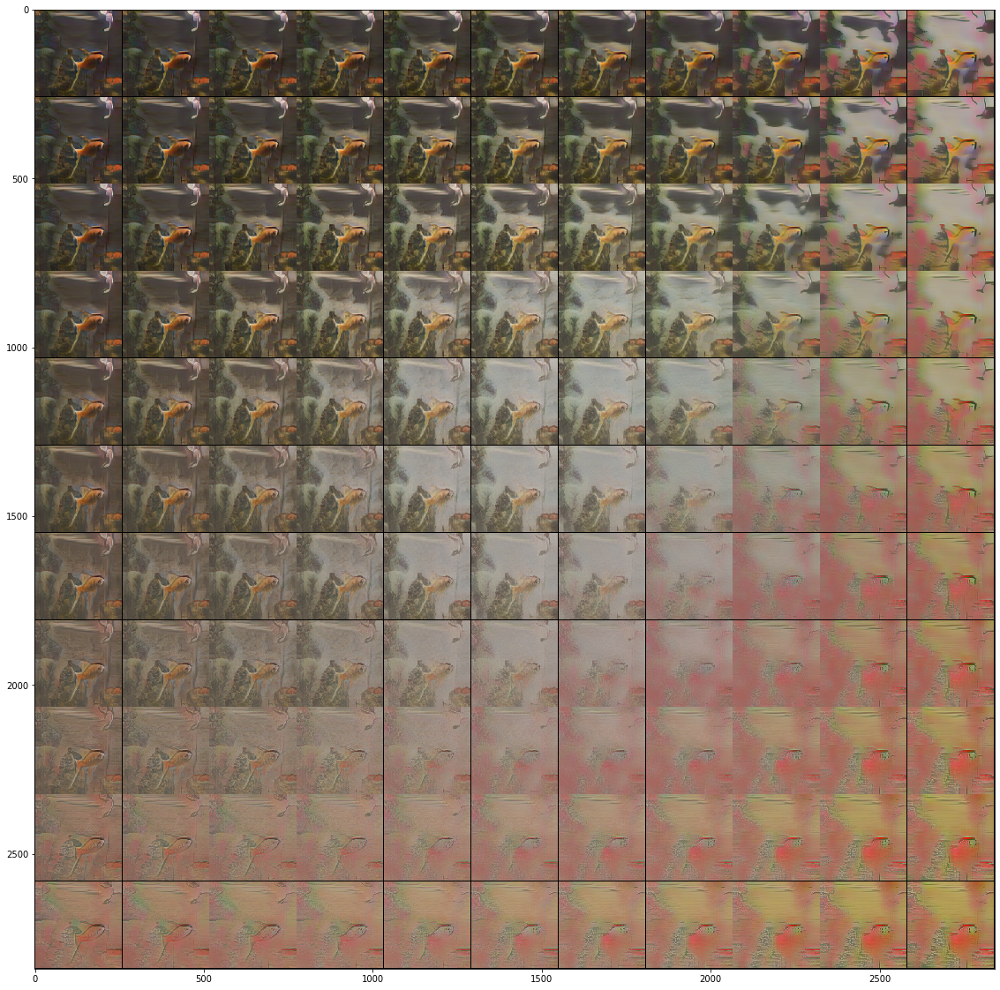

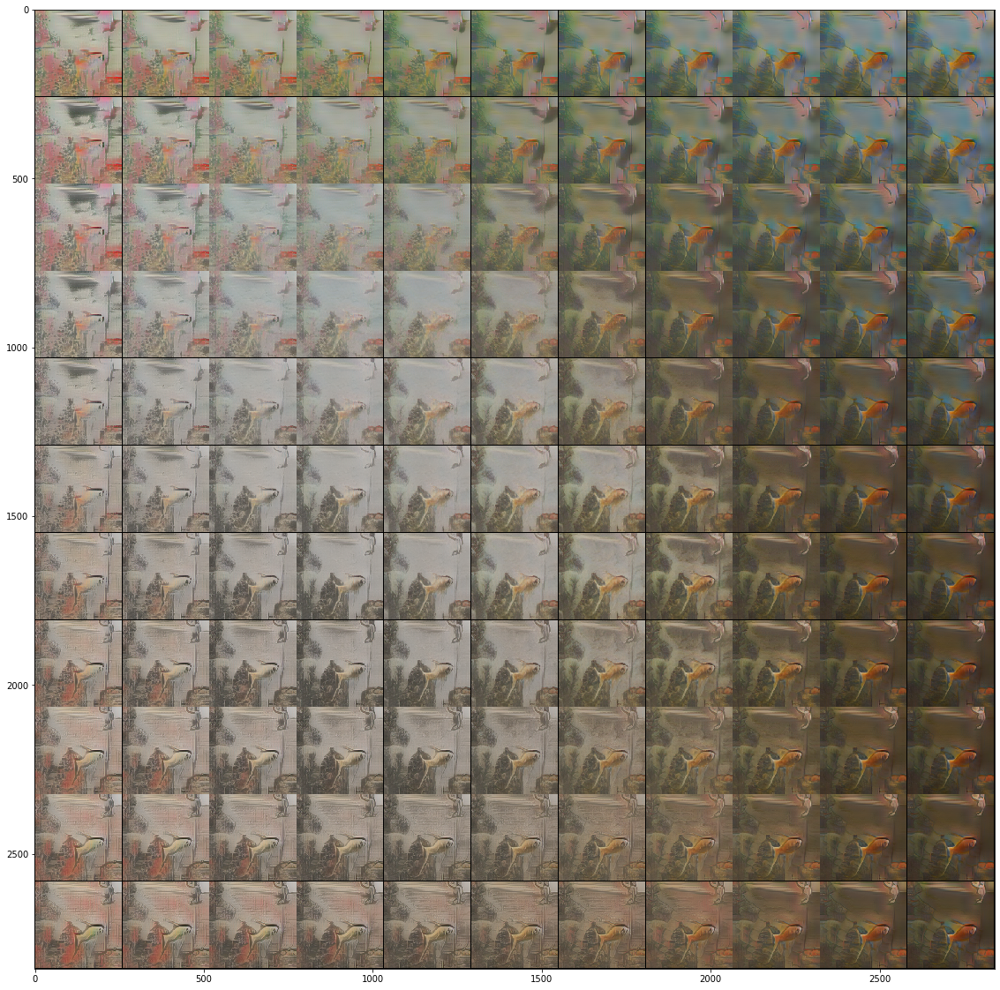

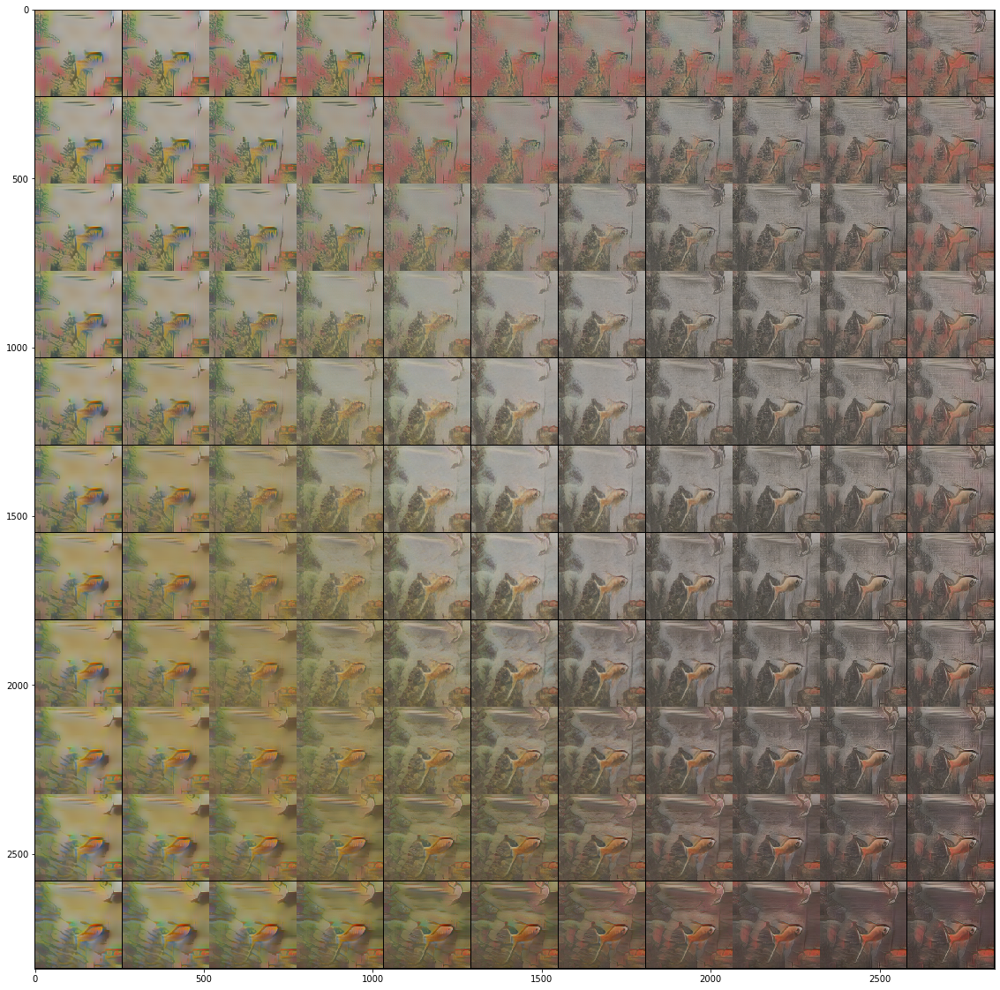

In [51]:
for i in range(10):
    v1, v2 = get_orth()
    grid = style_grid(v1, v2)
    plt.figure(figsize=(20,20))
    show(grid)